In [1]:
import os
import imageio
from tqdm import tqdm
import pdb
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F

import json
from skimage.metrics import structural_similarity as ssim
import scipy.signal as signal
import pickle
import scipy

import sys
sys.path.append('models/')
sys.path.append('data/')
from resunet_pf import ResUNet
from IO import *

"""
if torch.cuda.is_available():
    device = 'cuda'
else:
    device = 'cpu'
"""
## if has GPU, use cuda
device = 'cpu'

%load_ext autoreload
%autoreload 2

In [2]:
import lpips
alex_loss_fn = lpips.LPIPS(net = 'alex')
vgg_loss_fn = lpips.LPIPS(net = 'vgg')
def percep_loss(img, gt, loss_fn):
    img = torch.from_numpy(img.transpose(2,0,1).astype(np.float32)).unsqueeze(0)
    gt = torch.from_numpy(gt.transpose(2,0,1).astype(np.float32)).unsqueeze(0)
    return loss_fn(img, gt).item()

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /home/szhbchr/miniconda3/lib/python3.9/site-packages/lpips/weights/v0.1/alex.pth
Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /home/szhbchr/miniconda3/lib/python3.9/site-packages/lpips/weights/v0.1/vgg.pth


## Evaluate on Synthetic Data

In [3]:
from data_utils import stn, mod_flash, get_dshift_pattern, get_pattern_raw, get_ft3d_fd_eval, get_simu_eval

/home/szhbchr/miniconda3/lib/python3.9/site-packages/torch/nn/functional.py:4043: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(
/home/szhbchr/miniconda3/lib/python3.9/site-packages/torch/nn/functional.py:3981: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(
/home/szhbchr/miniconda3/lib/python3.9/site-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /opt/conda/conda-bld/pytorch_1623448238472/work/c10/core/Tenso

Scene 0: Uniform Flash, power = 0.007, PSNR = 27.12, SSIM = 0.82, LPIPS = 0.46
Scene 0: Patterned Flash, power = 0.007, PSNR = 28.31, SSIM = 0.85, LPIPS = 0.36
Scene 1: Uniform Flash, power = 0.007, PSNR = 27.73, SSIM = 0.88, LPIPS = 0.37
Scene 1: Patterned Flash, power = 0.007, PSNR = 28.92, SSIM = 0.91, LPIPS = 0.29


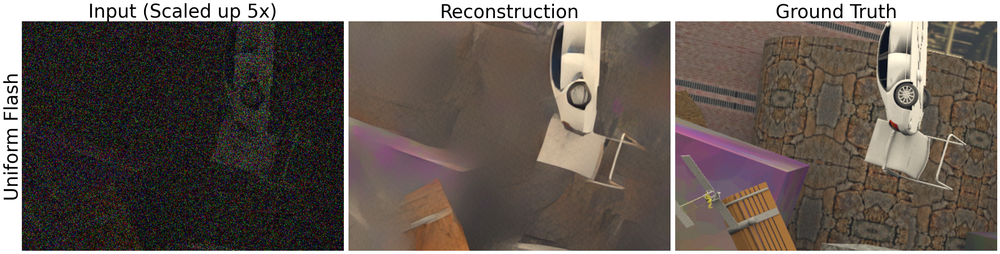

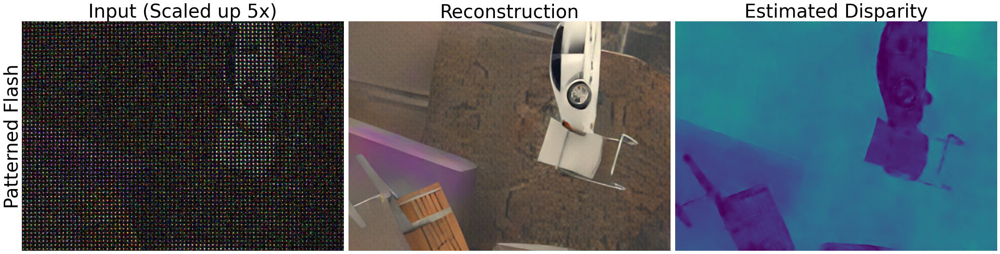

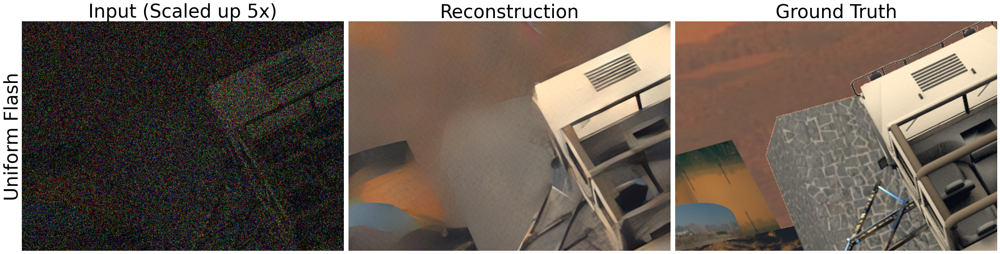

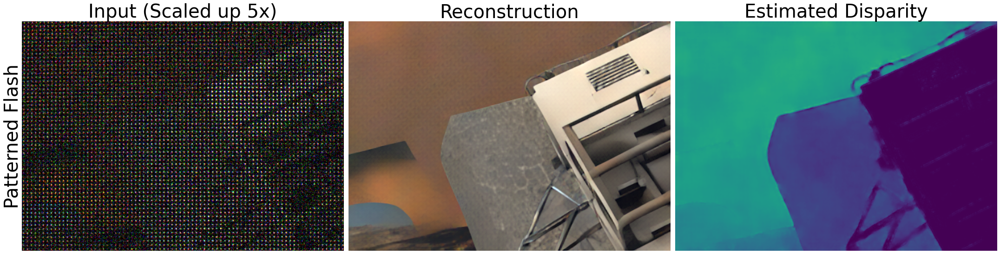

In [4]:
for jj in range(2):
    """
    simulation parameters
    """
    simu_kwargs = {'poiss_K': 1.5, 'noise': 0.004,  ## noise
                   'crop_H': 320, 'crop_W': 448,  ## image cropping
                   'baseline': 5.0,  ## baseline
                   'fname': jj,  ## file id
                   'depth_clip': 1.5,  ## depth clip
                   'power': 0.007, ## flash power
                   'boost': 16, ## pattern boost
                   'train': False ## evaluation mode
                  } 

    pattern_names = {'pf': 'Patterned Flash', 'uf': 'Uniform Flash'}
    for pattern_type in ['uf', 'pf']:
        """
        load pretrained model
        """
        model_dir = 'checkpoints/{}_pretrained.pth'.format(pattern_type)
        model = ResUNet(in_chans = 8, out_chans = 5, disp_clip = simu_kwargs['baseline'])
        model.to(device)
        model_state_dict = torch.load(model_dir)
        model.load_state_dict(model_state_dict)
        model.eval()

        """
        load synthetic data
        """
        flash, depth = get_ft3d_fd_eval(**simu_kwargs)
        pattern_calib = np.load('captured_data/{}_pattern_calib.npy'.format(pattern_type)).astype(np.float32)
        img_flash = get_simu_eval(pattern_calib, flash, depth, **simu_kwargs)

        """
        reconstruction
        """
        with torch.no_grad():
            restore = model(torch.from_numpy(img_flash.transpose(2,0,1)).to(device).unsqueeze(0)).cpu().numpy()[0].transpose(1,2,0)
        restore[...,0] *= np.mean(flash[...,0])/np.mean(restore[...,0])
        restore[...,1] *= np.mean(flash[...,1])/np.mean(restore[...,1])
        restore[...,2] *= np.mean(flash[...,2])/np.mean(restore[...,2])

        """
        compute metrices
        """
        ssim_stat = ssim(restore[...,:3], flash[...,:3], multichannel=True)
        psnr_stat = 20*np.log10(1/np.sqrt(np.mean((flash[...,:3] - restore[...,:3])**2)))
        lpips_stat = percep_loss(restore[...,:3], flash[...,:3], vgg_loss_fn)

        print('Scene {}: {}, power = {}, PSNR = {}, SSIM = {}, LPIPS = {}'.format(jj, pattern_names[pattern_type], \
                simu_kwargs['power'], np.round(psnr_stat,2), np.round(ssim_stat,2), np.round(lpips_stat, 2)))

        """
        plot input and result, scale images for better visualization
        """
        fig, ax = plt.subplots(1,3,figsize = (30,10))
        ax[0].imshow(np.clip(img_flash[...,:3]*5, 0.0, 1.0))
        ax[0].text(0.0, 0.5, pattern_names[pattern_type],
            horizontalalignment='right',
            verticalalignment='center',
            rotation='vertical',
            transform=ax[0].transAxes, fontsize = 40.0)
        ax[0].set_title('Input (Scaled up 5x)', fontsize = 40.0)
        ax[1].imshow(np.clip(restore[...,:3] * 1.5, 0.0, 1.0))
        ax[1].set_title('Reconstruction', fontsize = 40.0)
        if pattern_type == 'pf':
            ax[2].imshow(np.abs(restore[...,-1]), vmin = 0.0, vmax = simu_kwargs['baseline'])
            ax[2].set_title('Estimated Disparity', fontsize = 40.0)
        else:
            ax[2].imshow(np.clip(flash[...,:3] * 1.5, 0.0, 1.0))
            ax[2].set_title('Ground Truth', fontsize = 40.0)

        for ii in range(3):
            ax[ii].axis('off')
        plt.tight_layout()


## Evaluate on Real-world Data (zero baseline)

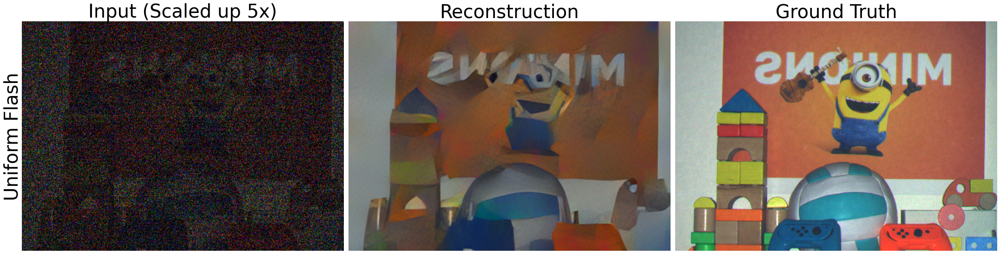

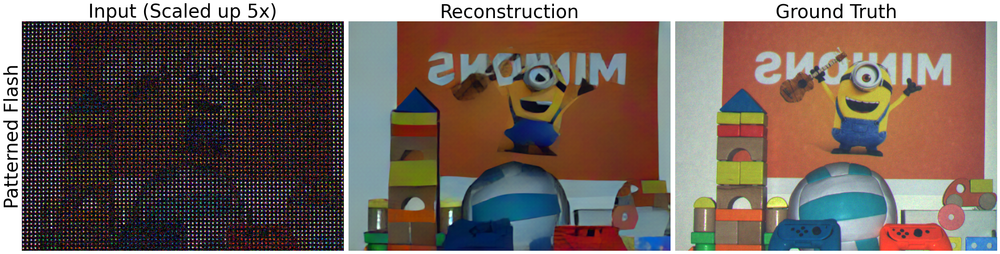

In [5]:
color_matrix = np.asarray([[1.59,-0.43,-0.16],[-0.25,1.71,-0.47],[-0.06,-0.41,1.46]])
## calibrated camera color matrix

pattern_names = {'pf': 'Patterned Flash', 'uf': 'Uniform Flash'}
for pattern_type in ['uf', 'pf']:
    """
    load model
    """
    model_dir = 'checkpoints/{}_pretrained.pth'.format(pattern_type)
    model = ResUNet(in_chans = 8, out_chans = 5, disp_clip = 3.0)
    model.to(device)
    model_state_dict = torch.load(model_dir)
    model.load_state_dict(model_state_dict)
    model.eval()

    """
    load data: RGGB raw + calibrated pattern
    """
    inp_load = np.load('captured_data/{}_scene2.npy'.format(pattern_type))
    gt = np.load('captured_data/gt_scene2.npy')

    """
    reconstruction
    """
    with torch.no_grad():
        restore = model(torch.from_numpy(inp_load.transpose(2,0,1)).unsqueeze(0).to(device)).cpu().numpy()[0].transpose(1,2,0)
    restore[...,0] *= np.mean(gt[...,0])/np.mean(restore[...,0])
    restore[...,1] *= np.mean(gt[...,1])/np.mean(restore[...,1])
    restore[...,2] *= np.mean(gt[...,2])/np.mean(restore[...,2])
    
    """
    plot input and result, white balance and scale images for better visualization
    """
    gt_wb = (color_matrix @ (gt[...,:3]*1.5).transpose(2,0,1).reshape(3,-1)).reshape(3,320,448).transpose(1,2,0)
    restore_wb = (color_matrix @ restore[...,:3].transpose(2,0,1).reshape(3,-1)).reshape(3,320,448).transpose(1,2,0)

    fig, ax = plt.subplots(1,3,figsize = (30,10))
    ax[0].imshow(np.clip(inp_load[...,:3]*5, 0.0, 1.0))
    ax[0].text(0.0, 0.5, pattern_names[pattern_type],
        horizontalalignment='right',
        verticalalignment='center',
        rotation='vertical',
        transform=ax[0].transAxes, fontsize = 40.0)
    ax[0].set_title('Input (Scaled up 5x)', fontsize = 40.0)
    ax[1].imshow(np.clip(restore_wb, 0.0, 1.0))
    ax[1].set_title('Reconstruction', fontsize = 40.0)
    ax[2].imshow(np.clip(gt_wb, 0.0, 1.0))
    ax[2].set_title('Ground Truth', fontsize = 40.0)

    for ii in range(3):
        ax[ii].axis('off')
    plt.tight_layout()

## Evaluate on Real-world Data (non-zero baseline)
The scene is slightly misaligned with the zero-baseline case due to limitation in experiment

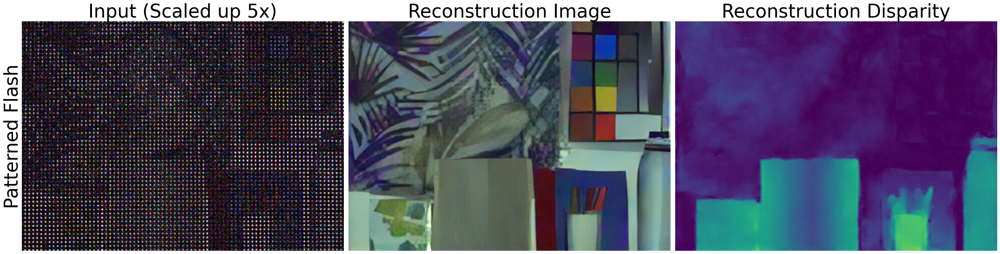

In [6]:
"""
load model
"""
model_dir = 'checkpoints/pf_pretrained.pth'
model = ResUNet(in_chans = 8, out_chans = 5, disp_clip = 3.0)
model.to(device)
model_state_dict = torch.load(model_dir)
model.load_state_dict(model_state_dict)
model.eval()

"""
load data: RGGB raw + calibrated pattern
"""
inp_load = np.load('captured_data/pf_scene1_shift.npy')
gt = np.load('captured_data/gt_scene1.npy')

"""
reconstruction
"""
with torch.no_grad():
    restore = model(torch.from_numpy(inp_load.transpose(2,0,1)).unsqueeze(0).to(device)).cpu().numpy()[0].transpose(1,2,0)
restore[...,0] *= np.mean(gt[...,0])/np.mean(restore[...,0])
restore[...,1] *= np.mean(gt[...,1])/np.mean(restore[...,1])
restore[...,2] *= np.mean(gt[...,2])/np.mean(restore[...,2])

"""
plot input and result, white balance and scale images for better visualization
"""
restore_wb = (color_matrix @ restore[...,:3].transpose(2,0,1).reshape(3,-1)).reshape(3,320,448).transpose(1,2,0)

fig, ax = plt.subplots(1,3,figsize = (30,10))
ax[0].imshow(np.clip(inp_load[...,:3]*5, 0.0, 1.0))
ax[0].text(0.0, 0.5, 'Patterned Flash',
    horizontalalignment='right',
    verticalalignment='center',
    rotation='vertical',
    transform=ax[0].transAxes, fontsize = 40.0)
ax[0].set_title('Input (Scaled up 5x)', fontsize = 40.0)
ax[1].imshow(np.clip(restore_wb, 0.0, 1.0))
ax[1].set_title('Reconstruction Image', fontsize = 40.0)
ax[2].imshow(np.abs(restore[...,-2]), vmin = 0.0, vmax = 3.0)
ax[2].set_title('Reconstruction Disparity', fontsize = 40.0)

for ii in range(3):
    ax[ii].axis('off')
plt.tight_layout()


## Face Detection with Patterned Flash

+ First install Google MediaPipe Python interface in virtual env: https://google.github.io/mediapipe/getting_started/python.html
+ Then run "python face_detector_mpi.py" with the following processed images

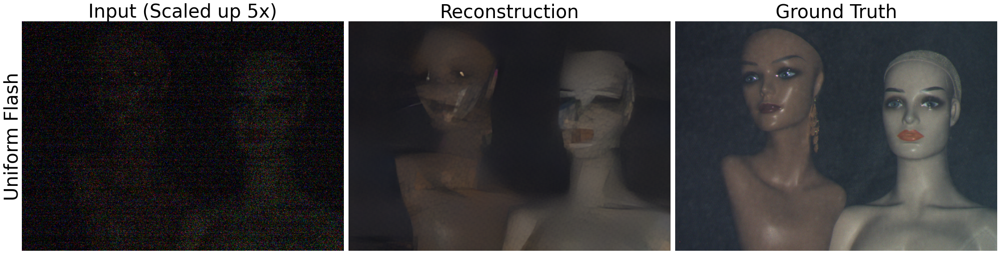

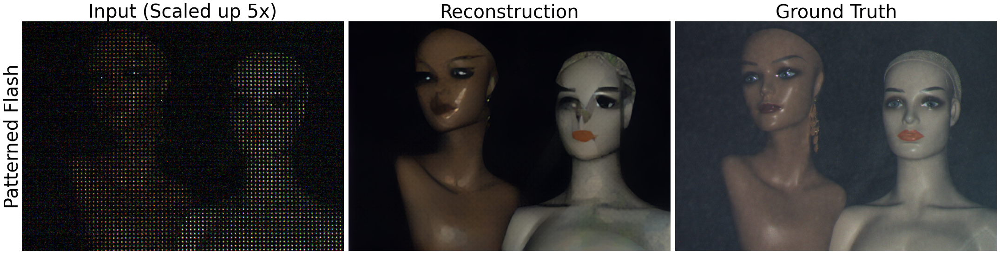

In [8]:
pattern_names = {'pf': 'Patterned Flash', 'uf': 'Uniform Flash'}
for pattern_type in ['uf', 'pf']:
    """
    load model
    """
    model_dir = 'checkpoints/{}_pretrained.pth'.format(pattern_type)
    model = ResUNet(in_chans = 8, out_chans = 5, disp_clip = 3.0)
    model.to(device)
    model_state_dict = torch.load(model_dir)
    model.load_state_dict(model_state_dict)
    model.eval()

    """
    load data: RGGB raw + calibrated pattern
    """
    inp_load = np.load('captured_data/{}_face_scene.npy'.format(pattern_type))
    gt = np.load('captured_data/gt_face_scene.npy')

    """
    reconstruction
    """
    with torch.no_grad():
        restore = model(torch.from_numpy(inp_load.transpose(2,0,1)).unsqueeze(0).to(device)).cpu().numpy()[0].transpose(1,2,0)
    
    fig, ax = plt.subplots(1,3,figsize = (30,10))
    ax[0].imshow(np.clip(inp_load[...,:3]*5, 0.0, 1.0))
    ax[0].text(0.0, 0.5, pattern_names[pattern_type],
        horizontalalignment='right',
        verticalalignment='center',
        rotation='vertical',
        transform=ax[0].transAxes, fontsize = 40.0)
    ax[0].set_title('Input (Scaled up 5x)', fontsize = 40.0)
    ax[1].imshow(np.clip(restore[...,:3]*1.2, 0.0, 1.0))
    ax[1].set_title('Reconstruction', fontsize = 40.0)
    ax[2].imshow(np.clip(gt, 0.0, 1.0))
    ax[2].set_title('Ground Truth', fontsize = 40.0)

    for ii in range(3):
        ax[ii].axis('off')
    plt.tight_layout()
    
    imageio.imwrite('face_det/{}_face_det.png'.format(pattern_type), (np.clip(restore[...,:3]*1.2, 0.0, 1.0)*255.0).astype(np.uint8))
    imageio.imwrite('face_det/gt_face_det.png'.format(pattern_type), (np.clip(gt, 0.0, 1.0)*255.0).astype(np.uint8))

## After running the "face_detector_mpi.py" script, visualize detection results

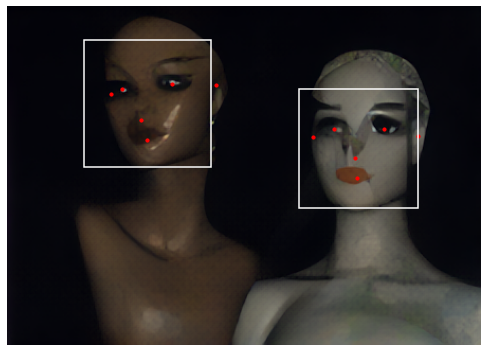

In [10]:
H = 320
W = 448

import matplotlib.patches as patches
with open('face_det/mediapipe_detection/det_result_pf_face_det.pickle', 'rb') as f:
    det = pickle.load(f)
img = imageio.imread('face_det/pf_face_det.png')

fig, ax = plt.subplots(1,1,figsize = (10,5))
plt.imshow(img)

for dd in range(2):
    bbox = det[dd]['bbox']
    rect = patches.Rectangle((bbox[0]*W, bbox[1]*H), bbox[2]*W, bbox[3]*H, \
                             linewidth=1.5, edgecolor='white', facecolor='none')
    ax.add_patch(rect)

    kp = det[dd]['kp']
    plt.scatter(kp[:,0]*W, kp[:,1]*H, color = 'red', s = 10.0)
plt.axis('off')
plt.tight_layout()